In [5]:
import os
from pathlib import Path

import missingno as msno
import pandas as pd
from src.data_acquisition.entso_e.entso_e import EntsoeHook
from src.data_acquisition.epex_sftp.intraday_transactions_new_format import (
    execute_etl_transactions_new_format,
)
from src.data_acquisition.epex_sftp.intraday_transactions_old_format import (
    execute_etl_transactions_old_format,
)
from src.data_acquisition.postgres_db.postgres_db_hooks import ThesisDBHook
from dateutil.relativedelta import relativedelta
from dotenv import load_dotenv

import importlib, src.data_acquisition.entso_e.entso_e as entsoe_mod
importlib.reload(entsoe_mod)
from src.data_acquisition.entso_e.entso_e import fill_database_with_entsoe_data

load_dotenv()

pd.options.plotting.backend = "plotly"
POSTGRES_USERNAME = os.getenv("POSTGRES_USER")
POSTGRES_DB_HOST = os.getenv("POSTGRES_DB_HOST")

# ETL ENTSO-E data into DB

In [7]:
start = pd.Timestamp(2019, 1, 1, tz="Europe/Berlin")
end   = pd.Timestamp(2023, 12, 22, tz="Europe/Berlin")
fill_database_with_entsoe_data(start, end)

/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning: The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution
  warnings.warn('The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution', DeprecationWarning)
/Users/timflaschel/Documents/GitHub/BessBidder1/.venv/lib/python3.10/site-packages/entsoe/entsoe.py:1256: DeprecationWarning: The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution
  warnings.warn('The resolution parameter is deprecated and will be removed. This function will force the right SDAC resolution', DeprecationWarning)
2025-10-22 11:08:17.129 | INFO     | src.data_acquisition.postgres_db.postgres_db_hooks:_create_table:98 - Table entsoe_prices already exists.
2025-10-22 11:08:17.130 | INFO     | src.data_acquisition.postgres_db.postgres_db_h

In [8]:
thesis_db_hook = ThesisDBHook(username=POSTGRES_USERNAME, hostname=POSTGRES_DB_HOST)
exaa_prices = thesis_db_hook.get_auction_prices(
    start=start, end=end, id="exaa_15min_de_lu_eur_per_mwh"
)

In [9]:
exaa_prices

,exaa_15min_de_lu_eur_per_mwh
time,
2018-12-31 23:00:00+00:00,28.32
2019-01-01 00:00:00+00:00,10.07
2019-01-01 01:00:00+00:00,-4.08
2019-01-01 02:00:00+00:00,-9.91
2019-01-01 03:00:00+00:00,-7.41
...,...
2023-12-21 19:00:00+00:00,40.97
2023-12-21 20:00:00+00:00,33.15
2023-12-21 21:00:00+00:00,28.77


In [10]:
thesis_db_hook = ThesisDBHook(username=POSTGRES_USERNAME, hostname=POSTGRES_DB_HOST)

da_auction_prices = thesis_db_hook.get_auction_prices(
    start=start, end=end, id="epex_spot_60min_de_lu_eur_per_mwh"
)
exaa_auction_prices = thesis_db_hook.get_auction_prices(
    start=start, end=end, id="exaa_15min_de_lu_eur_per_mwh"
)

demand_df = thesis_db_hook.get_forecast(
    ids=["load_forecast_d_minus_1_1000_total_de_lu_mw"], start=start, end=end
)

vre_df = thesis_db_hook.get_forecast(
    ids=[
        "pv_forecast_d_minus_1_1000_de_lu_mw",
        "wind_offshore_forecast_d_minus_1_1000_de_lu_mw",
        "wind_onshore_forecast_d_minus_1_1000_de_lu_mw",
    ],
    start=start,
    end=end,
)

data = pd.concat([da_auction_prices, exaa_auction_prices, demand_df, vre_df], axis=1)

In [11]:
data_hourly = data.resample("h").mean()

In [12]:
output_path = Path("data")
if not os.path.exists(output_path):
    os.makedirs(output_path)
data_hourly.to_csv(Path(output_path, "data_2019-01-01_2024-01-01_hourly.csv"))

<Axes: >

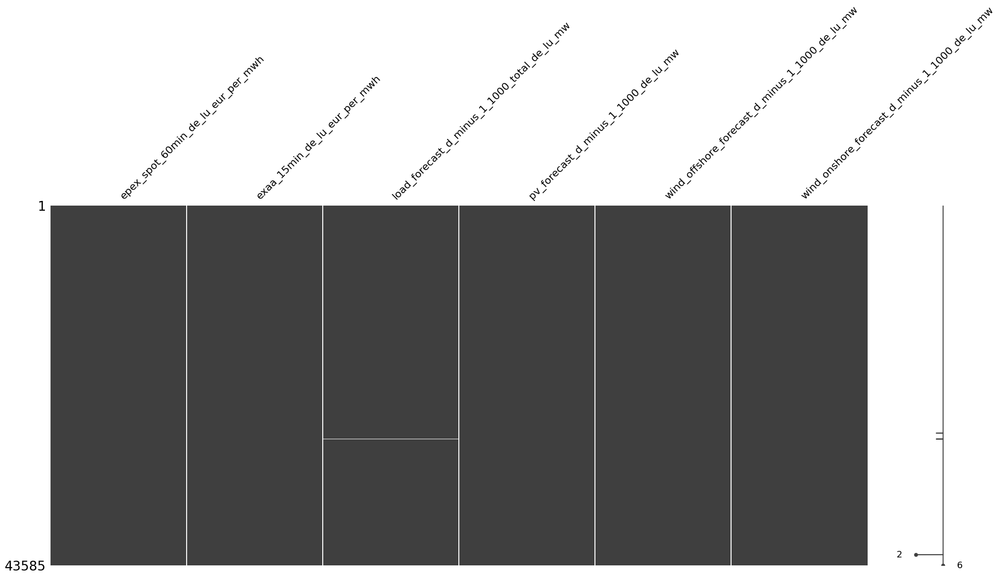

In [13]:
msno.matrix(data.resample("h").mean())

<Axes: >

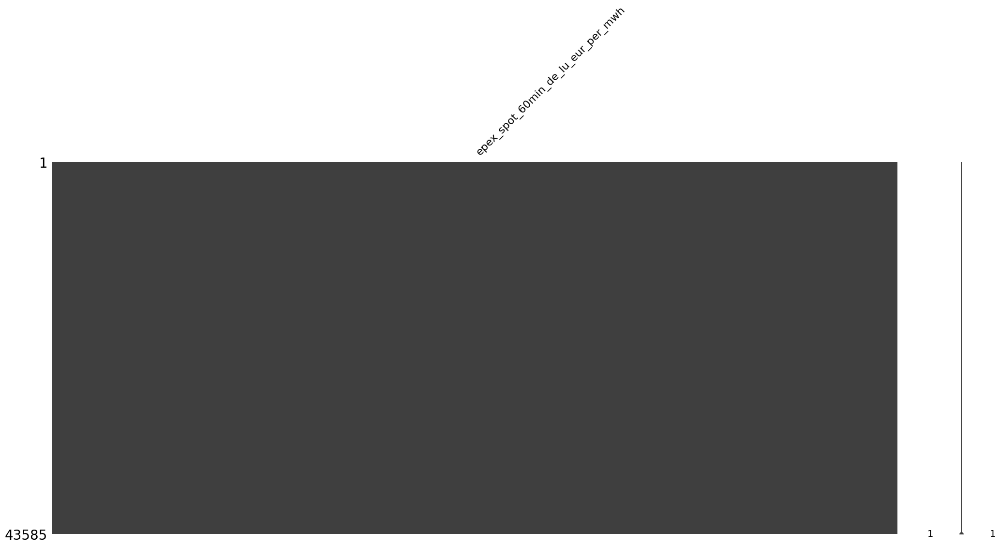

In [14]:
msno.matrix(da_auction_prices)

<Axes: >

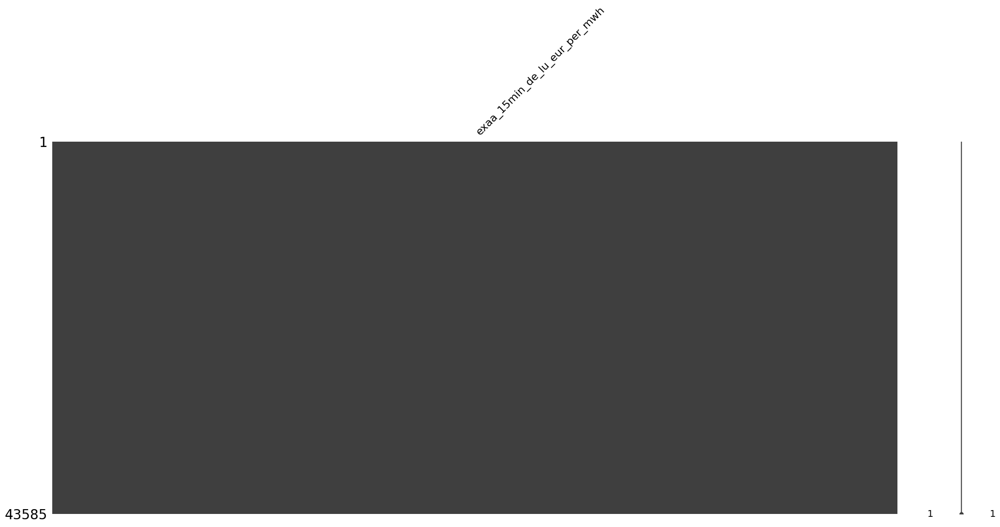

In [15]:
msno.matrix(exaa_prices)

<Axes: >

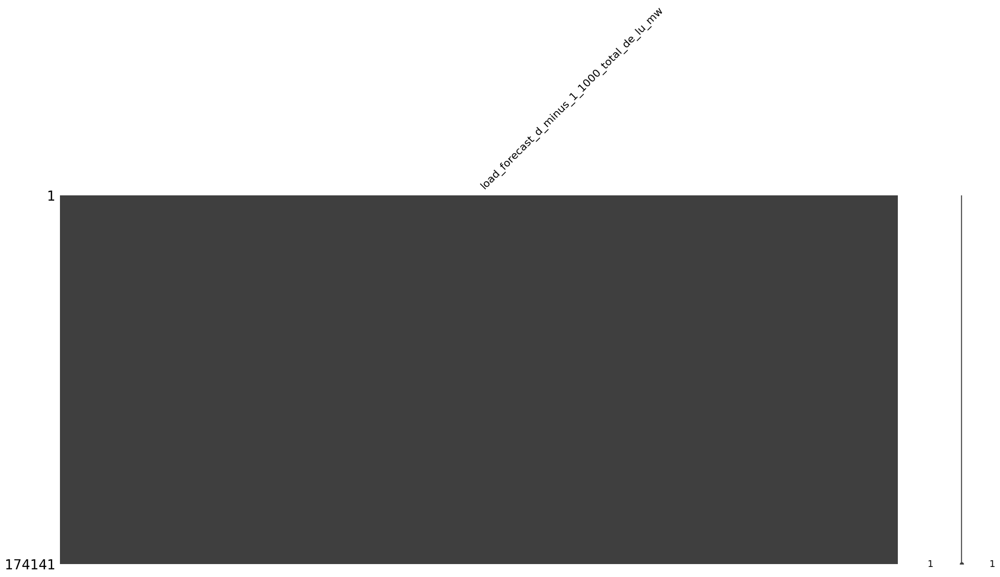

In [16]:
msno.matrix(demand_df)

<Axes: >

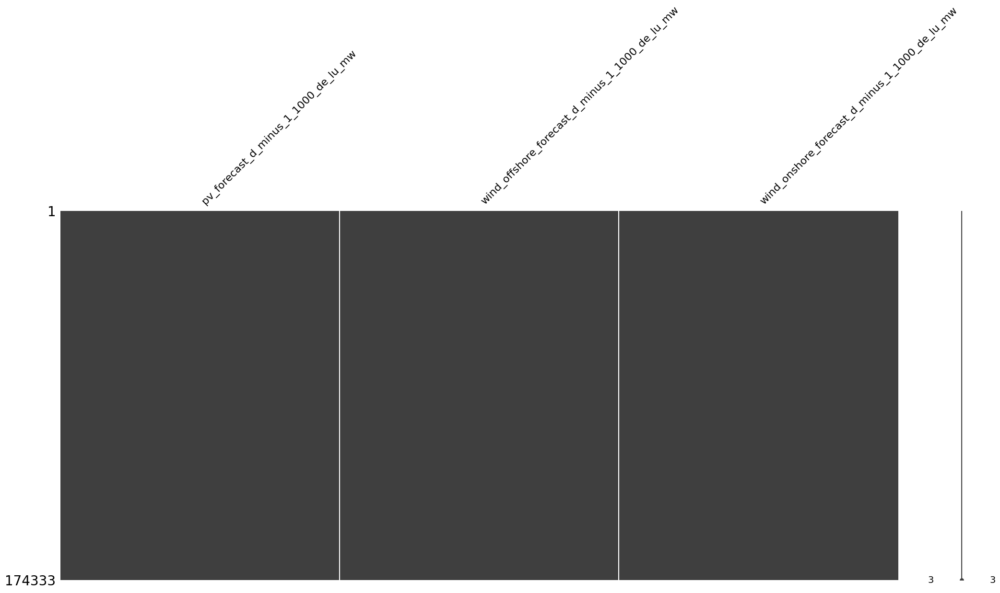

In [17]:
msno.matrix(vre_df)

In [18]:
exaa_prices.plot()

In [19]:
da_auction_prices.plot()

In [20]:
demand_df.plot()

In [21]:
vre_df["pv_forecast_d_minus_1_1000_de_lu_mw"].plot()

In [22]:
vre_df["wind_onshore_forecast_d_minus_1_1000_de_lu_mw"].plot()

In [23]:
vre_df["wind_offshore_forecast_d_minus_1_1000_de_lu_mw"].plot()

# ETL Transaction data from epex spot sftp (old format)

In [24]:
execute_etl_transactions_old_format(years=[2019, 2020])

# ETL Transaction data from epex spot sftp (new format)

In [26]:
execute_etl_transactions_new_format(years=[2021, 2022, 2023])

PermissionError: [Errno 1] Operation not permitted: '/dev/shm'